In [ ]:
! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip

     | 17.8 MB 39.4 MB/s 0:00:01
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 686.1/686.1 kB 20.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 104.8/104.8 kB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 63.1 MB/s eta 0:00:00
  Created wheel for ydata-profiling: filename=ydata_profiling-0.0.dev0-py2.py3-none-any.whl size=356222 sha256=64981feb2ba73a0f9a5a4635d81a680761464c528e026ba6f5493be554adf4ae
  Stored in directory: /tmp/pip-ephem-wheel-cache-zu_a7fg4/wheels/07/29/61/f533cc7cbd0a97efb2d1b94d3254a3e859a949367ba842577b
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=b751952ab4351edc67578a64d4e4cf1bcf8826286490a966170237a0bc5744fd
  Stored in directory: /root/.cache/pip/wheels/dd/91/29/a79cecb328d01739e64017b6fb9a1ab9d8cb1853098ec5966d
Succe

In [28]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [5]:
df=pd.read_csv('spotify-2023.csv', encoding='ISO-8859-1')

In [ ]:
pd.set_option("display.max_columns", None)

In [6]:
df.head()

,track_name,artist(s)_name,artist_count,released_year,released_month,released_day,in_spotify_playlists,in_spotify_charts,streams,in_apple_playlists,...,bpm,key,mode,danceability_%,valence_%,energy_%,acousticness_%,instrumentalness_%,liveness_%,speechiness_%
0,Seven (feat. Latto) (Explicit Ver.),"Latto, Jung Kook",2,2023,7,14,553,147,141381703,43,...,125,B,Major,80,89,83,31,0,8,4
1,LALA,Myke Towers,1,2023,3,23,1474,48,133716286,48,...,92,C#,Major,71,61,74,7,0,10,4
2,vampire,Olivia Rodrigo,1,2023,6,30,1397,113,140003974,94,...,138,F,Major,51,32,53,17,0,31,6
3,Cruel Summer,Taylor Swift,1,2019,8,23,7858,100,800840817,116,...,170,A,Major,55,58,72,11,0,11,15
4,WHERE SHE GOES,Bad Bunny,1,2023,5,18,3133,50,303236322,84,...,144,A,Minor,65,23,80,14,63,11,6


- dancebality /(spotify_charts/deezer/apple/apple)
- musicas de 2023 que tem (danceability etc)
-

In [ ]:
relatorio=ProfileReport(df,title='Relatorio spotify')


relatorio.to_file('relatorio_spotify.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:

relatorio

In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 953 entries, 0 to 952
Data columns (total 24 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   track_name            953 non-null    object
 1   artist(s)_name        953 non-null    object
 2   artist_count          953 non-null    int64 
 3   released_year         953 non-null    int64 
 4   released_month        953 non-null    int64 
 5   released_day          953 non-null    int64 
 6   in_spotify_playlists  953 non-null    int64 
 7   in_spotify_charts     953 non-null    int64 
 8   streams               953 non-null    object
 9   in_apple_playlists    953 non-null    int64 
 10  in_apple_charts       953 non-null    int64 
 11  in_deezer_playlists   953 non-null    object
 12  in_deezer_charts      953 non-null    int64 
 13  in_shazam_charts      903 non-null    object
 14  bpm                   953 non-null    int64 
 15  key                   858 non-null    ob

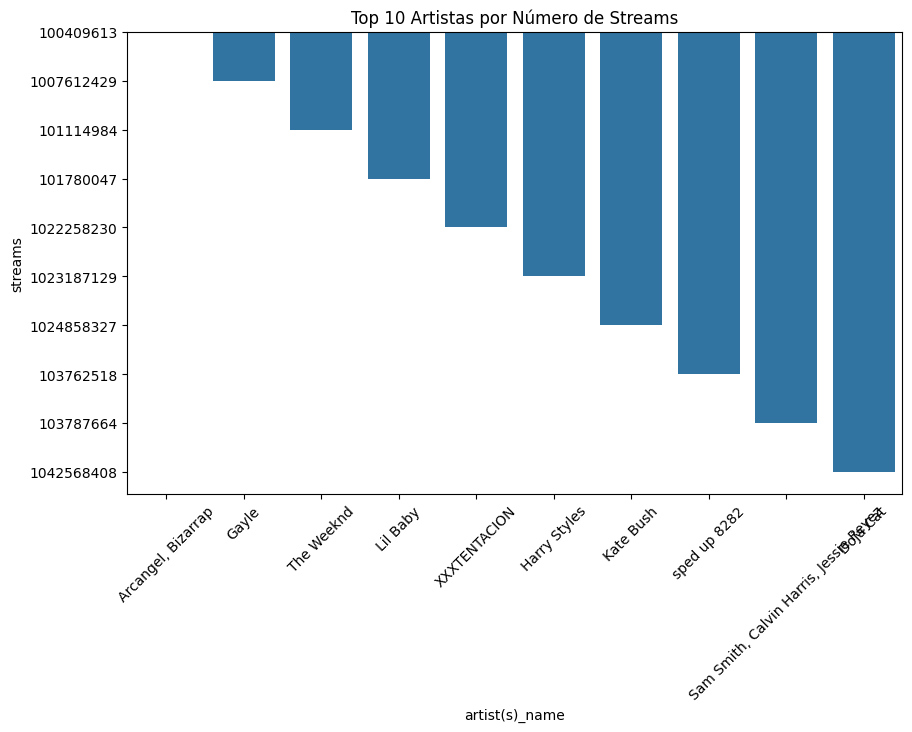

In [15]:
# Análise de popularidade
plt.figure(figsize=(10, 6))
sns.barplot(x='artist(s)_name', y='streams', data=df.sort_values('streams', ascending=True).head(10))
plt.title('Top 10 Artistas por Número de Streams')
plt.xticks(rotation=45)
plt.show()


In [17]:
valor_anomalo = 'BPM110KeyAModeMajorDanceability53Valence75Energy69Acousticness7Instrumentalness0Liveness17Speechiness3'

# Removendo a linha que contém o valor anômalo na coluna 'streams'
df = df[df['streams'] != valor_anomalo]


In [23]:
def treat_data(df):
    # Tratando colunas object que deveriam ser numéricas
    numeric_columns = ['streams', 'in_deezer_playlists', 'in_shazam_charts']
    for col in numeric_columns:
        df[col] = pd.to_numeric(df[col], errors='coerce')

    # Tratando a coluna 'key'
    df['key'] = df['key'].fillna('Unknown')

    # Convertendo colunas de porcentagem para float
    percentage_columns = ['danceability_%', 'valence_%', 'energy_%', 'acousticness_%',
                          'instrumentalness_%', 'liveness_%', 'speechiness_%']
    for col in percentage_columns:
        df[col] = df[col] / 100
        df = df.rename(columns={col: col.replace('_%', '')})

    # Tratando a coluna 'mode'
    #df['mode'] = df['mode'].map({'Major': 1, 'Minor': 0})

    # Convertendo datas para datetime
    df['release_date'] = pd.to_datetime(df[['released_year', 'released_month', 'released_day']].astype(str).agg('-'.join, axis=1))

    # Removendo linhas com valores ausentes
    df = df.dropna()

    return df

# Aplicando o tratamento
df = treat_data(df)


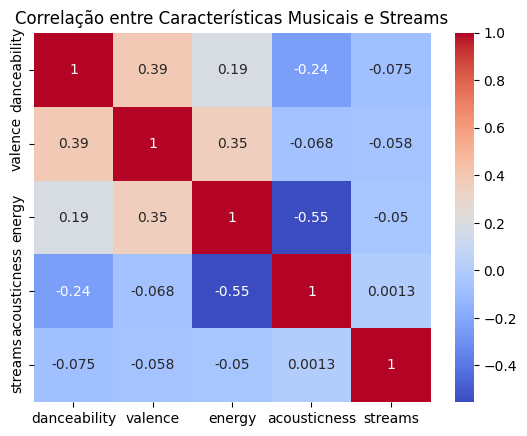

In [25]:
# Análise de características musicais
correlation_matrix = df[['danceability', 'valence', 'energy', 'acousticness', 'streams']].corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlação entre Características Musicais e Streams')
plt.show()


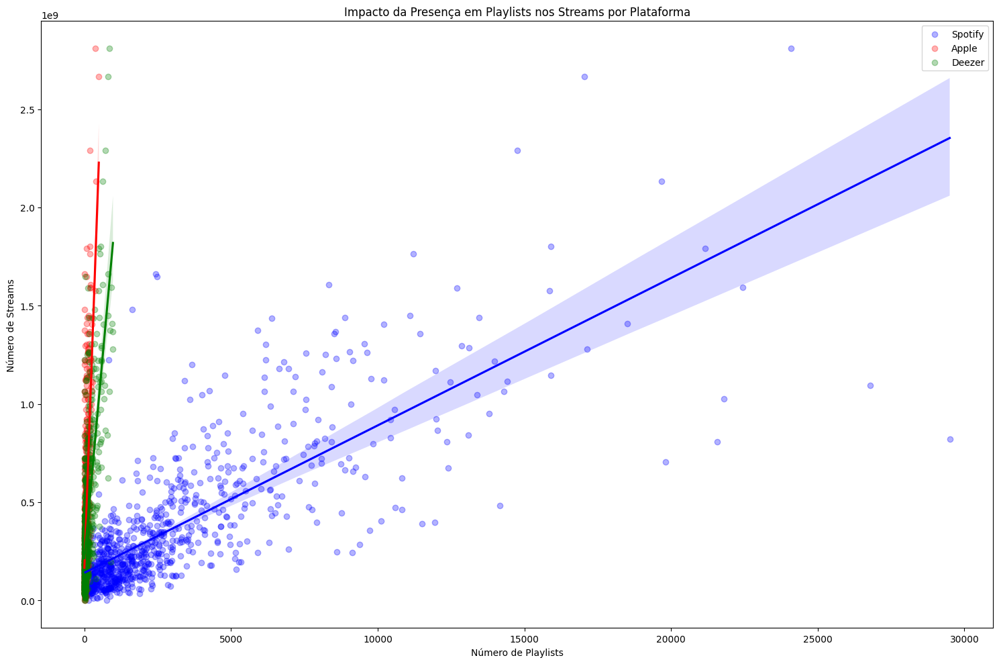


Correlações entre presença em playlists e streams:
in_spotify_playlists    0.765095
in_apple_playlists      0.663657
in_deezer_playlists     0.718593
Name: streams, dtype: float64


In [26]:
df['streams'] = pd.to_numeric(df['streams'], errors='coerce')

# Criando o gráfico
plt.figure(figsize=(15, 10))

platforms = ['spotify', 'apple', 'deezer']
colors = ['blue', 'red', 'green']

for platform, color in zip(platforms, colors):
    sns.regplot(x=f'in_{platform}_playlists',
                y='streams',
                data=df,
                scatter=True,
                fit_reg=True,
                color=color,
                label=platform.capitalize(),
                scatter_kws={'alpha':0.3})

plt.title('Impacto da Presença em Playlists nos Streams por Plataforma')
plt.xlabel('Número de Playlists')
plt.ylabel('Número de Streams')
plt.legend()
plt.tight_layout()
plt.show()

# Calculando as correlações
correlations = df[[f'in_{platform}_playlists' for platform in platforms] + ['streams']].corr()['streams'].drop('streams')
print("\nCorrelações entre presença em playlists e streams:")
print(correlations)

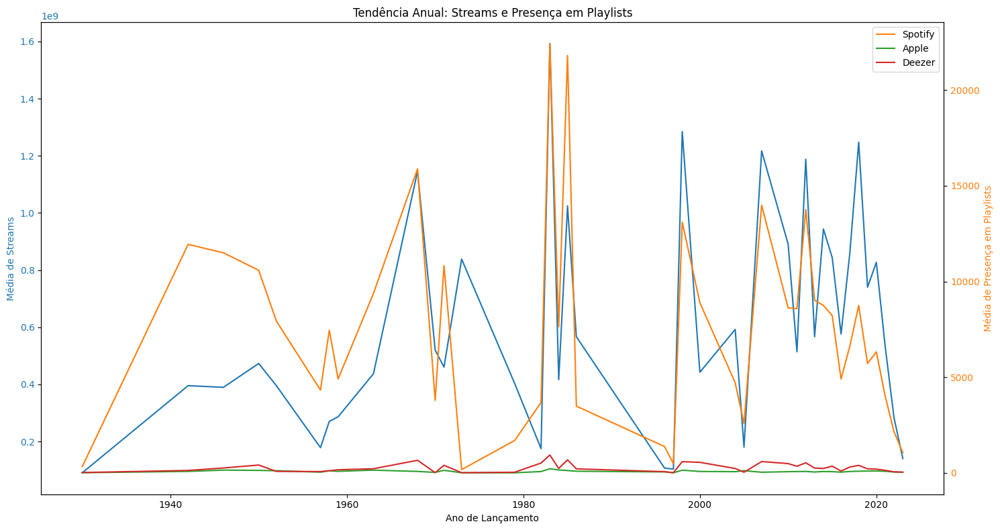

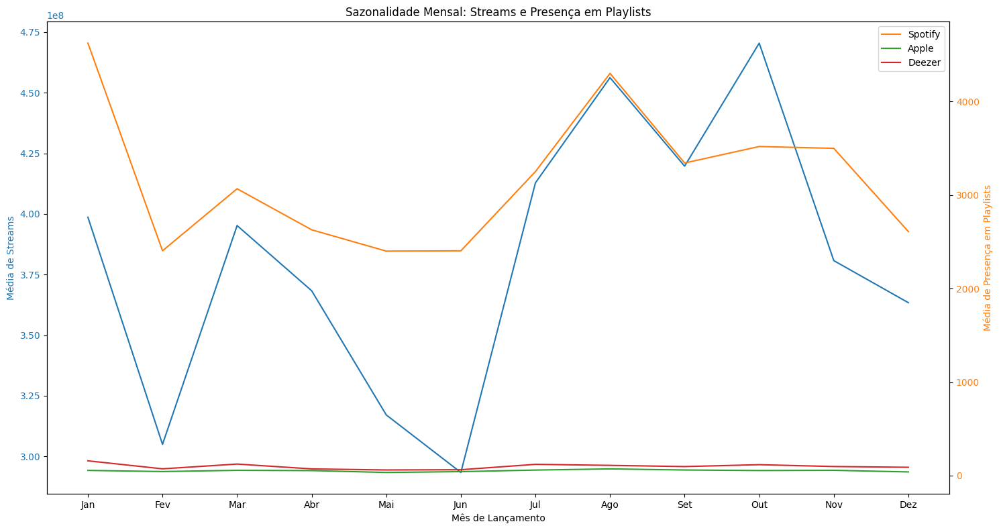

Correlação entre ano de lançamento e streams: -0.14835092690041216
Correlação entre mês de lançamento e streams: 0.47221503626924644


In [27]:
# Análise por Ano
yearly_data = df.groupby(df['release_date'].dt.year).agg({
    'streams': 'mean',
    'in_spotify_playlists': 'mean',
    'in_apple_playlists': 'mean',
    'in_deezer_playlists': 'mean'
}).reset_index()

# Gráfico de Tendência Anual
fig, ax1 = plt.subplots(figsize=(15, 8))

ax1.set_xlabel('Ano de Lançamento')
ax1.set_ylabel('Média de Streams', color='tab:blue')
ax1.plot(yearly_data['release_date'], yearly_data['streams'], color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')

ax2 = ax1.twinx()
ax2.set_ylabel('Média de Presença em Playlists', color='tab:orange')
ax2.plot(yearly_data['release_date'], yearly_data['in_spotify_playlists'], color='tab:orange', label='Spotify')
ax2.plot(yearly_data['release_date'], yearly_data['in_apple_playlists'], color='tab:green', label='Apple')
ax2.plot(yearly_data['release_date'], yearly_data['in_deezer_playlists'], color='tab:red', label='Deezer')
ax2.tick_params(axis='y', labelcolor='tab:orange')

plt.title('Tendência Anual: Streams e Presença em Playlists')
plt.legend()
plt.tight_layout()
plt.show()

# Análise por Mês
monthly_data = df.groupby(df['release_date'].dt.month).agg({
    'streams': 'mean',
    'in_spotify_playlists': 'mean',
    'in_apple_playlists': 'mean',
    'in_deezer_playlists': 'mean'
}).reset_index()

# Gráfico de Sazonalidade Mensal
fig, ax1 = plt.subplots(figsize=(15, 8))

ax1.set_xlabel('Mês de Lançamento')
ax1.set_ylabel('Média de Streams', color='tab:blue')
ax1.plot(monthly_data['release_date'], monthly_data['streams'], color='tab:blue')
ax1.tick_params(axis='y', labelcolor='tab:blue')

ax2 = ax1.twinx()
ax2.set_ylabel('Média de Presença em Playlists', color='tab:orange')
ax2.plot(monthly_data['release_date'], monthly_data['in_spotify_playlists'], color='tab:orange', label='Spotify')
ax2.plot(monthly_data['release_date'], monthly_data['in_apple_playlists'], color='tab:green', label='Apple')
ax2.plot(monthly_data['release_date'], monthly_data['in_deezer_playlists'], color='tab:red', label='Deezer')
ax2.tick_params(axis='y', labelcolor='tab:orange')

plt.title('Sazonalidade Mensal: Streams e Presença em Playlists')
plt.legend()
plt.xticks(range(1, 13), ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez'])
plt.tight_layout()
plt.show()

# Análise estatística
print("Correlação entre ano de lançamento e streams:",
      df['released_year'].corr(df['streams']))

monthly_corr = df.groupby(df['release_date'].dt.month)['streams'].mean().corr(pd.Series(range(1, 13)))
print("Correlação entre mês de lançamento e streams:", monthly_corr)

In [29]:
yearly_data = df.groupby(df['release_date'].dt.year).agg({
    'streams': 'mean',
    'in_spotify_playlists': 'mean',
    'in_apple_playlists': 'mean',
    'in_deezer_playlists': 'mean'
}).reset_index()

# Gráfico de Tendência Anual
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(x=yearly_data['release_date'], y=yearly_data['streams'], name="Streams"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=yearly_data['release_date'], y=yearly_data['in_spotify_playlists'], name="Spotify Playlists"),
    secondary_y=True,
)

fig.add_trace(
    go.Scatter(x=yearly_data['release_date'], y=yearly_data['in_apple_playlists'], name="Apple Playlists"),
    secondary_y=True,
)

fig.add_trace(
    go.Scatter(x=yearly_data['release_date'], y=yearly_data['in_deezer_playlists'], name="Deezer Playlists"),
    secondary_y=True,
)

fig.update_layout(
    title_text="Tendência Anual: Streams e Presença em Playlists",
    xaxis_title="Ano de Lançamento",
)

fig.update_yaxes(title_text="Média de Streams", secondary_y=False)
fig.update_yaxes(title_text="Média de Presença em Playlists", secondary_y=True)

fig.show()

# Análise por Mês
monthly_data = df.groupby(df['release_date'].dt.month).agg({
    'streams': 'mean',
    'in_spotify_playlists': 'mean',
    'in_apple_playlists': 'mean',
    'in_deezer_playlists': 'mean'
}).reset_index()

# Gráfico de Sazonalidade Mensal
fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(x=monthly_data['release_date'], y=monthly_data['streams'], name="Streams"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=monthly_data['release_date'], y=monthly_data['in_spotify_playlists'], name="Spotify Playlists"),
    secondary_y=True,
)

fig.add_trace(
    go.Scatter(x=monthly_data['release_date'], y=monthly_data['in_apple_playlists'], name="Apple Playlists"),
    secondary_y=True,
)

fig.add_trace(
    go.Scatter(x=monthly_data['release_date'], y=monthly_data['in_deezer_playlists'], name="Deezer Playlists"),
    secondary_y=True,
)

fig.update_layout(
    title_text="Sazonalidade Mensal: Streams e Presença em Playlists",
    xaxis_title="Mês de Lançamento",
    xaxis = dict(
        tickmode = 'array',
        tickvals = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
        ticktext = ['Jan', 'Fev', 'Mar', 'Abr', 'Mai', 'Jun', 'Jul', 'Ago', 'Set', 'Out', 'Nov', 'Dez']
    )
)

fig.update_yaxes(title_text="Média de Streams", secondary_y=False)
fig.update_yaxes(title_text="Média de Presença em Playlists", secondary_y=True)

fig.show()

# Análise estatística
print("Correlação entre ano de lançamento e streams:",
      df['released_year'].corr(df['streams']))

monthly_corr = df.groupby(df['release_date'].dt.month)['streams'].mean().corr(pd.Series(range(1, 13)))
print("Correlação entre mês de lançamento e streams:", monthly_corr)

Correlação entre ano de lançamento e streams: -0.14835092690041216
Correlação entre mês de lançamento e streams: 0.47221503626924644


In [31]:
# Preparar os dados
key_mode_data = df.groupby(['key', 'mode']).agg({
    'streams': 'mean',
    'track_name': 'count'
}).reset_index()

key_mode_data = key_mode_data.rename(columns={'track_name': 'count'})

# Criar o primeiro gráfico: Média de streams por Key e Mode
fig1 = px.bar(key_mode_data,
              x='key',
              y='streams',
              color='mode',
              barmode='group',
              title='Média de Streams por Key e Mode',
              labels={'streams': 'Média de Streams', 'key': 'Key', 'mode': 'Mode'},
              hover_data=['count'])

fig1.update_layout(xaxis_title='Key',
                   yaxis_title='Média de Streams',
                   legend_title='Mode')

fig1.show()


# Análise estatística
print("Top 5 combinações de Key e Mode por média de streams:")
print(key_mode_data.sort_values('streams', ascending=False).head())

print("\nTop 5 combinações de Key e Mode por frequência:")
print(key_mode_data.sort_values('count', ascending=False).head())

# Calcular e imprimir correlações
correlation_key = df.groupby('key')['streams'].mean().corr(pd.Series(range(len(df['key'].unique()))))
correlation_mode = df.groupby('mode')['streams'].mean().corr(pd.Series([0 if m == 'Minor' else 1 for m in df['mode'].unique()]))

print(f"\nCorrelação entre Key e média de streams: {correlation_key:.2f}")
print(f"Correlação entre Mode e média de streams: {correlation_mode:.2f}")

Top 5 combinações de Key e Mode por média de streams:
        key   mode       streams  count
10       D#  Major  5.112327e+08     10
12        E  Major  4.679448e+08     13
5         B  Minor  4.660406e+08     42
22  Unknown  Major  4.373082e+08     67
2        A#  Major  4.325846e+08     24

Top 5 combinações de Key e Mode por frequência:
        key   mode       streams  count
22  Unknown  Major  4.373082e+08     67
6        C#  Major  4.047869e+08     61
8         D  Major  4.171482e+08     56
18        G  Major  3.162276e+08     54
20       G#  Major  3.930917e+08     53

Correlação entre Key e média de streams: nan
Correlação entre Mode e média de streams: nan


In [34]:
# Criar categorias de valence
df['valence_category'] = pd.cut(df['valence'],
                                bins=[0, 0.2, 0.4, 0.6, 0.8, 1.0],
                                labels=['Muito Baixa', 'Baixa', 'Média', 'Alta', 'Muito Alta'])

# Calcular médias por categoria de valence
valence_stats = df.groupby('valence_category').agg({
    'in_spotify_charts': 'mean',
    'in_apple_charts': 'mean',
    'in_deezer_charts': 'mean',
    'in_shazam_charts': 'mean',
    'streams': 'mean'
}).reset_index()

# Gráfico 1: Presença nos Charts por Categoria de Valence
fig1 = go.Figure()

for chart in ['in_spotify_charts', 'in_apple_charts', 'in_deezer_charts', 'in_shazam_charts']:
    fig1.add_trace(go.Bar(
        x=valence_stats['valence_category'],
        y=valence_stats[chart],
        name=chart.replace('in_', '').replace('_charts', '').capitalize()
    ))

fig1.update_layout(
    title='Presença nos Charts por Categoria de Valence',
    xaxis_title='Categoria de Valence',
    yaxis_title='Média de Presença nos Charts',
    barmode='group'
)

fig1.show()

<ipython-input-34-2b0b2345254a>:7: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [36]:
valence_stats

,valence_category,in_spotify_charts,in_apple_charts,in_deezer_charts,in_shazam_charts,streams
0,Muito Baixa,9.500000,46.032609,1.760870,32.565217,4.526488e+08
1,Baixa,9.489796,42.862245,1.994898,68.066327,3.422532e+08
2,Média,12.323404,48.119149,2.251064,39.038298,4.178043e+08
3,Alta,9.363184,47.049751,2.542289,43.169154,3.227000e+08
4,Muito Alta,13.885714,54.180952,3.314286,58.952381,3.632635e+08


In [37]:
emotion_data = df.groupby(['key', 'mode']).agg({
    'valence': 'mean',
    'energy': 'mean',
    'track_name': 'count'  # para ver a quantidade de músicas em cada combinação
}).reset_index()

# Criar pivots para valence e energy
valence_pivot = emotion_data.pivot(index='key', columns='mode', values='valence')
energy_pivot = emotion_data.pivot(index='key', columns='mode', values='energy')
count_pivot = emotion_data.pivot(index='key', columns='mode', values='track_name')

# Criar subplots
fig = make_subplots(rows=1, cols=2, subplot_titles=("Valence por Key e Mode", "Energy por Key e Mode"))

# Adicionar heatmap para Valence
fig.add_trace(
    go.Heatmap(z=valence_pivot.values,
               x=valence_pivot.columns,
               y=valence_pivot.index,
               colorscale='RdYlGn',
               zmin=0, zmax=1,
               colorbar=dict(title="Valence", x=0.45),
               hovertemplate="Key: %{y}<br>Mode: %{x}<br>Valence: %{z:.2f}<br>Count: %{text}",
               text=count_pivot.values),
    row=1, col=1
)

# Adicionar heatmap para Energy
fig.add_trace(
    go.Heatmap(z=energy_pivot.values,
               x=energy_pivot.columns,
               y=energy_pivot.index,
               colorscale='Viridis',
               zmin=0, zmax=1,
               colorbar=dict(title="Energy", x=1.0),
               hovertemplate="Key: %{y}<br>Mode: %{x}<br>Energy: %{z:.2f}<br>Count: %{text}",
               text=count_pivot.values),
    row=1, col=2
)

# Atualizar layout
fig.update_layout(
    title_text="Correlação entre Keys/Modes e Emoções (Valence e Energy)",
    height=600,
    width=1000
)

fig.show()

# Análise estatística
print("Top 5 combinações de Key e Mode por Valence:")
print(emotion_data.sort_values('valence', ascending=False).head())

print("\nTop 5 combinações de Key e Mode por Energy:")
print(emotion_data.sort_values('energy', ascending=False).head())

# Calcular correlações
correlation_key_valence = df.groupby('key')['valence'].mean().corr(pd.Series(range(len(df['key'].unique()))))
correlation_key_energy = df.groupby('key')['energy'].mean().corr(pd.Series(range(len(df['key'].unique()))))
correlation_mode_valence = df.groupby('mode')['valence'].mean().corr(pd.Series([0 if m == 'Minor' else 1 for m in df['mode'].unique()]))
correlation_mode_energy = df.groupby('mode')['energy'].mean().corr(pd.Series([0 if m == 'Minor' else 1 for m in df['mode'].unique()]))

print(f"\nCorrelação entre Key e Valence média: {correlation_key_valence:.2f}")
print(f"Correlação entre Key e Energy média: {correlation_key_energy:.2f}")
print(f"Correlação entre Mode e Valence média: {correlation_mode_valence:.2f}")
print(f"Correlação entre Mode e Energy média: {correlation_mode_energy:.2f}")

Top 5 combinações de Key e Mode por Valence:
   key   mode   valence    energy  track_name
19   G  Minor  0.604828  0.685862          29
16  F#  Major  0.590357  0.644286          28
21  G#  Minor  0.587308  0.646538          26
17  F#  Minor  0.576286  0.657429          35
3   A#  Minor  0.566071  0.620714          28

Top 5 combinações de Key e Mode por Energy:
        key   mode   valence    energy  track_name
5         B  Minor  0.534524  0.702619          42
19        G  Minor  0.604828  0.685862          29
13        E  Minor  0.443000  0.670500          40
22  Unknown  Major  0.539254  0.666716          67
20       G#  Major  0.501509  0.666038          53

Correlação entre Key e Valence média: nan
Correlação entre Key e Energy média: nan
Correlação entre Mode e Valence média: nan
Correlação entre Mode e Energy média: nan


In [39]:
df['is_collaborative'] = df['artist_count'] > 1

# Calcular médias para métricas de sucesso
success_metrics = ['streams', 'in_spotify_playlists', 'in_apple_playlists', 'in_deezer_playlists']
avg_metrics = df.groupby('is_collaborative')[success_metrics].mean().reset_index()

# Criar subplots
fig = make_subplots(rows=2, cols=2, subplot_titles=("Streams", "Spotify Playlists", "Apple Music Playlists", "Deezer Playlists"))

# Adicionar barras para cada métrica
for i, metric in enumerate(success_metrics):
    row = i // 2 + 1
    col = i % 2 + 1

    fig.add_trace(
        go.Bar(x=['Solo', 'Collaborative'],
               y=avg_metrics[metric],
               text=avg_metrics[metric].round(0),
               textposition='auto',
               name=metric),
        row=row, col=col
    )

# Atualizar layout
fig.update_layout(height=800, width=1000, title_text="Comparação de Métricas de Sucesso: Artistas Solo vs. Colaborativos")
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')

fig.show()

# Gráfico de distribuição de streams
fig_dist = px.histogram(df, x="streams", color="is_collaborative",
                        marginal="box",
                        hover_data=df.columns,
                        labels={'is_collaborative': 'Tipo'},
                        color_discrete_map={False: 'blue', True: 'red'},
                        title="Distribuição de Streams: Artistas Solo vs. Colaborativos")

fig_dist.update_layout(xaxis_title="Número de Streams", yaxis_title="Contagem")
fig_dist.update_layout(legend_title_text="Tipo de Faixa")
fig_dist.update_layout(barmode='overlay')
fig_dist.update_traces(opacity=0.75)
fig_dist.show()

# Análise estatística
print("Média de métricas por tipo de faixa:")
print(avg_metrics)

print("\nMediana de streams:")
print(df.groupby('is_collaborative')['streams'].median())

print("\nCorrelação entre número de artistas e streams:")
print(df['artist_count'].corr(df['streams']))

# Top 10 faixas colaborativas e solo
top_collaborative = df[df['is_collaborative']].nlargest(10, 'streams')[['track_name', 'artist(s)_name', 'streams']]
top_solo = df[~df['is_collaborative']].nlargest(10, 'streams')[['track_name', 'artist(s)_name', 'streams']]

print("\nTop 10 faixas colaborativas:")
print(top_collaborative)

print("\nTop 10 faixas solo:")
print(top_solo)

Média de métricas por tipo de faixa:
   is_collaborative       streams  in_spotify_playlists  in_apple_playlists  \
0             False  3.986152e+08           3296.370221           48.273642   
1              True  3.367558e+08           2846.439759           51.798193   

   in_deezer_playlists  
0           105.213280  
1            84.069277  

Mediana de streams:
is_collaborative
False    267789608.0
True     210409637.5
Name: streams, dtype: float64

Correlação entre número de artistas e streams:
-0.10904686335602289

Top 10 faixas colaborativas:
                                        track_name  \
41   Sunflower - Spider-Man: Into the Spider-Verse   
84                       STAY (with Justin Bieber)   
433                      Levitating (feat. DaBaby)   
555                                         Dakiti   
516                       Kiss Me More (feat. SZA)   
87                                 Me Porto Bonito   
368                                    LA CANCIï¿½   
74       